In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import shutil
import cv2
import os
from tqdm import tqdm
import random

random.seed(42)

In [2]:
import timm
import torch

def gen_yolo_timm_config(model_name='seresnet50', input_size=640):
    model = timm.create_model(model_name, features_only=True, pretrained=False)
    dummy_input = torch.randn(1, 3, input_size, input_size)
    outputs = model(dummy_input)

    print(f"# Backbone config for timm model: {model_name}")
    print(f"- [-1, 1, Timm, [{outputs[-1].shape[1]}, '{model_name}', False, True, 0, True]]  # - 0")

    index_blocks = []
    for i, out in enumerate(outputs):
        c, h, w = out.shape[1:]
        index_blocks.append((i, c, h, w))

    # Auto-select last 3 outputs for P3, P4, P5
    selected = index_blocks[-3:]

    for idx, (i, c, h, w) in enumerate(selected):
        print(f"- [0, 1, Index, [{c}, {i}]]   # selects {i}th output (1, {c}, {w}, {h}) - {idx+1}")

    # SPPF
    sppf_in_channels = selected[-1][1]
    sppf_out_channels = sppf_in_channels // 2  # often reduced
    print(f"- [-1, 1, SPPF, [{sppf_out_channels}, 5]] # SPPF - {len(selected)+1}")

    # C2PSA
    print(f"- [-1, 2, C2PSA, [{sppf_out_channels}]]   # C2PSA - {len(selected)+2}")

gen_yolo_timm_config('mobilenetv3_large_100', input_size=640)

# Backbone config for timm model: mobilenetv3_large_100
- [-1, 1, Timm, [960, 'mobilenetv3_large_100', False, True, 0, True]]  # - 0
- [0, 1, Index, [40, 2]]   # selects 2th output (1, 40, 80, 80) - 1
- [0, 1, Index, [112, 3]]   # selects 3th output (1, 112, 40, 40) - 2
- [0, 1, Index, [960, 4]]   # selects 4th output (1, 960, 20, 20) - 3
- [-1, 1, SPPF, [480, 5]] # SPPF - 4
- [-1, 2, C2PSA, [480]]   # C2PSA - 5


In [3]:
!git clone https://github.com/VA0211/mri_timm.git

Cloning into 'mri_timm'...
remote: Enumerating objects: 914, done.
remote: Counting objects: 100% (914/914), done.
remote: Compressing objects: 100% (697/697), done.
remote: Total 914 (delta 238), reused 881 (delta 205), pack-reused 0 (from 0)
Receiving objects: 100% (914/914), 2.00 MiB | 16.65 MiB/s, done.
Resolving deltas: 100% (238/238), done.


In [4]:
# %pip install ultralytics
%cd /kaggle/working/mri_timm
%pip install -e .
import ultralytics
ultralytics.checks()

Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6170.1/8062.4 GB disk)


In [5]:
from ultralytics import YOLO

# Load a model
model = YOLO("/kaggle/working/mri_timm/ultralytics/cfg/models/11/11-mobilenet.yaml")

# Train the model
results = model.train(data="/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml", 
                      epochs=100,
                      patience=10,
                      imgsz=640,
                      pretrained=False,
                      device=0,
                      # batch=32,
                      # optimizer='AdamW',
                      # lr0=0.001,
                      # momentum=0.9,
                      )

WARNING ⚠️ no model scale passed. Assuming scale='s'.


model.safetensors:   0%|          | 0.00/22.1M [00:00<?, ?B/s]

New https://pypi.org/project/ultralytics/8.3.103 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=/kaggle/working/mri_timm/ultralytics/cfg/models/11/11-mobilenet.yaml, data=/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml, epochs=100, time=None, patience=10, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, a

100%|██████████| 755k/755k [00:00<00:00, 17.3MB/s]


Overriding model.yaml nc=80 with nc=3
WARNING ⚠️ no model scale passed. Assuming scale='s'.

                   from  n    params  module                                       arguments                     
  0                  -1  1   2971952  ultralytics.nn.modules.block.Timm            ['mobilenetv3_large_100', True, True, 0, True]
  1                   0  1         0  ultralytics.nn.modules.conv.Index            [2]                           
  2                   0  1         0  ultralytics.nn.modules.conv.Index            [3]                           
  3                   0  1         0  ultralytics.nn.modules.conv.Index            [4]                           
  4                  -1  1    923040  ultralytics.nn.modules.block.SPPF            [960, 240, 5]                 
  5                  -1  1    219720  ultralytics.nn.modules.block.C2PSA           [240, 240, 1]                 
  6                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 

100%|██████████| 5.35M/5.35M [00:00<00:00, 76.1MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/train/labels... 1740 images, 442 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:06<00:00, 249.22it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/val/labels... 217 images, 55 backgrounds, 0 corrupt: 100%|██████████| 217/217 [00:00<00:00, 263.03it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/val is not writeable, cache not saved.
Plotting labels to /kaggle/working/mri_timm/runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 96 weight(decay=0.0), 119 weight(decay=0.0005), 118 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /kaggle/working/mri_timm/runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      5.46G      3.085      5.538      3.763         14        640: 100%|██████████| 109/109 [00:38<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.28it/s]


                   all        217        163      0.634      0.193      0.235     0.0693

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      6.34G      2.438      3.281       2.81         12        640: 100%|██████████| 109/109 [00:37<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.56it/s]


                   all        217        163      0.492      0.534       0.53      0.225

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      6.36G      2.156      2.477      2.466         12        640: 100%|██████████| 109/109 [00:38<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.40it/s]

                   all        217        163      0.572      0.651      0.639      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      6.36G      2.034      2.046      2.327          8        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.47it/s]

                   all        217        163      0.699      0.674      0.718      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      6.36G      1.945      1.717      2.215         22        640: 100%|██████████| 109/109 [00:38<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.52it/s]


                   all        217        163      0.775      0.707      0.787      0.379

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      6.36G      1.894       1.54      2.159         20        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.42it/s]

                   all        217        163      0.797       0.75      0.817      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      6.36G      1.838       1.48      2.086         16        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.56it/s]


                   all        217        163      0.749      0.725      0.805      0.414

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      6.36G      1.822       1.43      2.091         12        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.52it/s]

                   all        217        163      0.833      0.804      0.845      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      6.36G      1.784      1.325      2.061         16        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.52it/s]


                   all        217        163      0.858      0.835      0.866      0.408

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      6.36G      1.764      1.248      2.003         15        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.54it/s]


                   all        217        163      0.764      0.819      0.849       0.44

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      6.36G      1.728      1.248      1.991         18        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.61it/s]

                   all        217        163      0.771      0.862      0.879       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      6.36G      1.737      1.186      1.995         21        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.57it/s]


                   all        217        163      0.884      0.864      0.901      0.449

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      6.36G      1.681      1.131      1.949         10        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.41it/s]

                   all        217        163      0.843      0.813      0.876       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      6.36G      1.693      1.122      1.941         15        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.57it/s]

                   all        217        163      0.887       0.88      0.924      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      6.36G      1.661      1.053      1.906         20        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.61it/s]

                   all        217        163      0.814      0.831      0.887      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      6.36G      1.654      1.041      1.905         14        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.59it/s]

                   all        217        163      0.874      0.857      0.921       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      6.36G      1.629      1.023      1.885         14        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.59it/s]

                   all        217        163      0.852      0.879      0.901      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      6.36G      1.655      1.044      1.899         12        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.56it/s]

                   all        217        163      0.839      0.815      0.888      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      6.36G      1.624     0.9907      1.852         15        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.55it/s]

                   all        217        163      0.858      0.844      0.894      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      6.36G      1.614     0.9712      1.858         11        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.47it/s]

                   all        217        163      0.839      0.862      0.904      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      6.36G      1.595     0.9369      1.839         15        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.62it/s]

                   all        217        163      0.877       0.83      0.915       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      6.36G      1.547     0.9234       1.79          7        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.59it/s]

                   all        217        163      0.887      0.853      0.911      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      6.36G      1.545     0.9291      1.822         10        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.65it/s]

                   all        217        163      0.888      0.831      0.904      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      6.36G      1.508     0.8789      1.777         15        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.64it/s]

                   all        217        163      0.925      0.895      0.941      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      6.36G      1.517     0.8798      1.781         13        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.61it/s]

                   all        217        163      0.842      0.832      0.891      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      6.36G      1.483     0.8391      1.771         12        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.53it/s]

                   all        217        163      0.865      0.872      0.911       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      6.36G      1.503     0.8801      1.787         10        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.50it/s]

                   all        217        163      0.829      0.866      0.883      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      6.36G       1.46     0.8503       1.71         16        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.61it/s]

                   all        217        163      0.852      0.881      0.908      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      6.36G      1.456     0.8386      1.737         17        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.60it/s]

                   all        217        163      0.876      0.862      0.909      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      6.36G      1.448     0.8244      1.707         11        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.65it/s]

                   all        217        163      0.888      0.854      0.912      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      6.36G       1.43     0.8039      1.714         12        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.63it/s]

                   all        217        163      0.906      0.908      0.935      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      6.36G      1.452     0.8142      1.711         14        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.58it/s]

                   all        217        163      0.904      0.836      0.905      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      6.36G      1.376      0.773      1.643         16        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.54it/s]


                   all        217        163      0.907      0.852      0.902      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      6.36G      1.403     0.7983      1.682         14        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.50it/s]

                   all        217        163      0.882      0.827      0.907      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      6.36G      1.382     0.7525      1.656         16        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.64it/s]

                   all        217        163       0.85      0.839      0.873      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      6.36G      1.379     0.7513      1.671         16        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.63it/s]

                   all        217        163      0.857      0.863      0.892      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      6.36G      1.387     0.7475      1.642         15        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.68it/s]

                   all        217        163      0.878      0.878      0.899      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      6.36G       1.35     0.7326      1.653         21        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.63it/s]

                   all        217        163      0.887      0.883      0.909      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      6.36G      1.299     0.7189      1.613          8        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.65it/s]

                   all        217        163      0.913      0.899      0.928      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      6.36G      1.319     0.7164      1.605         16        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.63it/s]

                   all        217        163      0.905      0.866      0.923      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      6.36G      1.299     0.7117      1.587          6        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.60it/s]


                   all        217        163       0.91      0.874      0.924      0.508

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      6.36G       1.28     0.6994      1.578         15        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.69it/s]

                   all        217        163        0.9       0.89      0.937      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      6.36G      1.252     0.6903      1.557         16        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.70it/s]

                   all        217        163      0.911      0.866      0.921      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      6.36G      1.269     0.6789       1.56         18        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.63it/s]


                   all        217        163       0.86      0.894      0.916      0.484

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      6.36G      1.262     0.6827      1.567         14        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.67it/s]

                   all        217        163      0.899      0.897      0.936      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      6.36G      1.252     0.6829      1.553         13        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.61it/s]

                   all        217        163      0.867      0.899      0.928      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      6.36G       1.25     0.6779       1.56         17        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.64it/s]

                   all        217        163      0.913      0.892      0.933      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      6.36G      1.233     0.6799      1.538         13        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.65it/s]

                   all        217        163       0.91      0.882      0.931      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      6.36G      1.201     0.6488      1.494         11        640: 100%|██████████| 109/109 [00:38<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.54it/s]

                   all        217        163      0.884      0.912      0.923      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      6.36G       1.18     0.6243      1.494         20        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.63it/s]

                   all        217        163      0.903      0.902      0.943      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      6.36G      1.172     0.6314      1.486         13        640: 100%|██████████| 109/109 [00:38<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.66it/s]

                   all        217        163      0.895      0.863      0.914      0.485


EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 41, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.

51 epochs completed in 0.582 hours.
Optimizer stripped from /kaggle/working/mri_timm/runs/detect/train/weights/last.pt, 16.1MB
Optimizer stripped from /kaggle/working/mri_timm/runs/detect/train/weights/best.pt, 16.1MB

Validating /kaggle/working/mri_timm/runs/detect/train/weights/best.pt...
Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
11-mobilenet summary: 281 layers, 7,819,609 parameters, 0 gradients, 14.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.84it/s]


                   all        217        163      0.911      0.874      0.924      0.508
             pituitary         62         63       0.96      0.921      0.943      0.524
            meningioma         55         55      0.874      0.945      0.953      0.555
                glioma         45         45      0.898      0.756      0.877      0.444


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 6.2ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to /kaggle/working/mri_timm/runs/detect/train


In [6]:
val_results = model.val(split='test')

Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
11-mobilenet summary: 281 layers, 7,819,609 parameters, 0 gradients, 14.1 GFLOPs


val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/test/labels... 218 images, 55 backgrounds, 0 corrupt: 100%|██████████| 218/218 [00:00<00:00, 297.41it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  3.98it/s]


                   all        218        164      0.932       0.88       0.92      0.475
             pituitary         62         62      0.942      0.968      0.979      0.473
            meningioma         55         55          1      0.991      0.995        0.6
                glioma         46         47      0.855      0.681      0.787      0.353


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 1.4ms preprocess, 10.2ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to /kaggle/working/mri_timm/runs/detect/train2


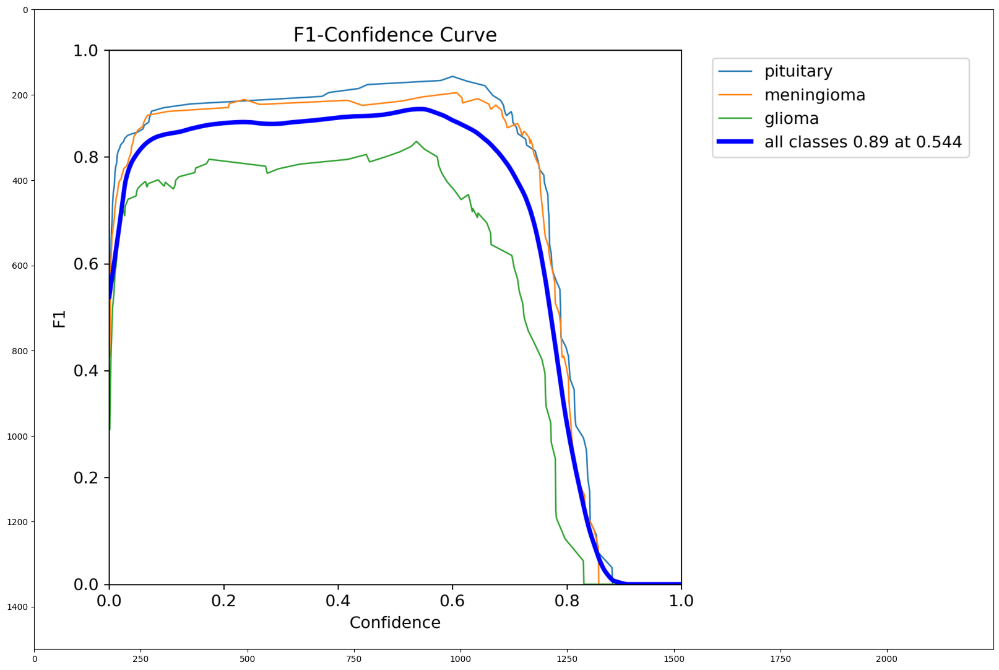

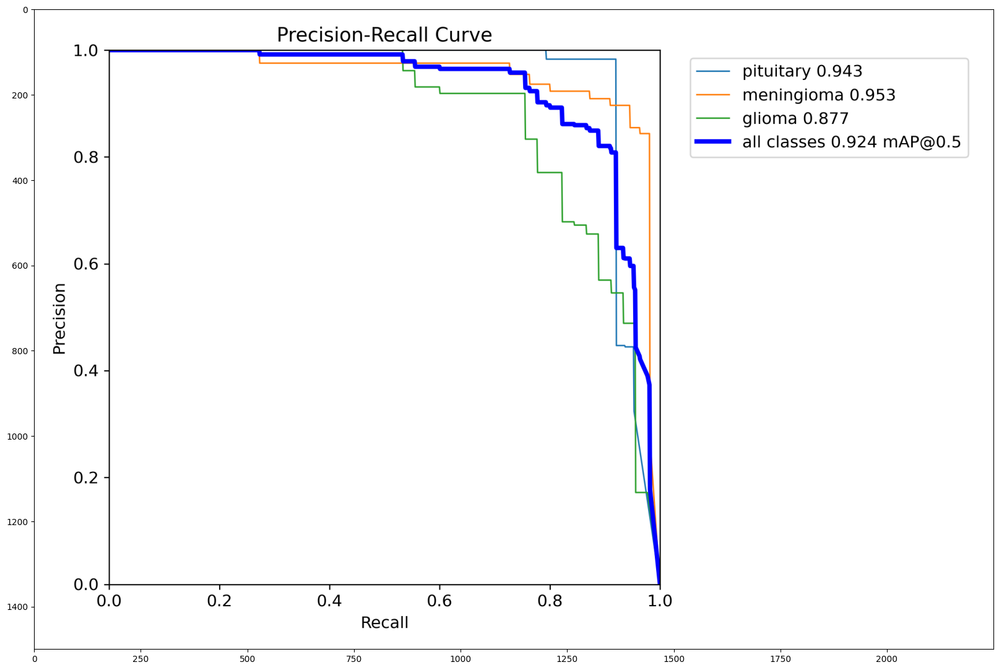

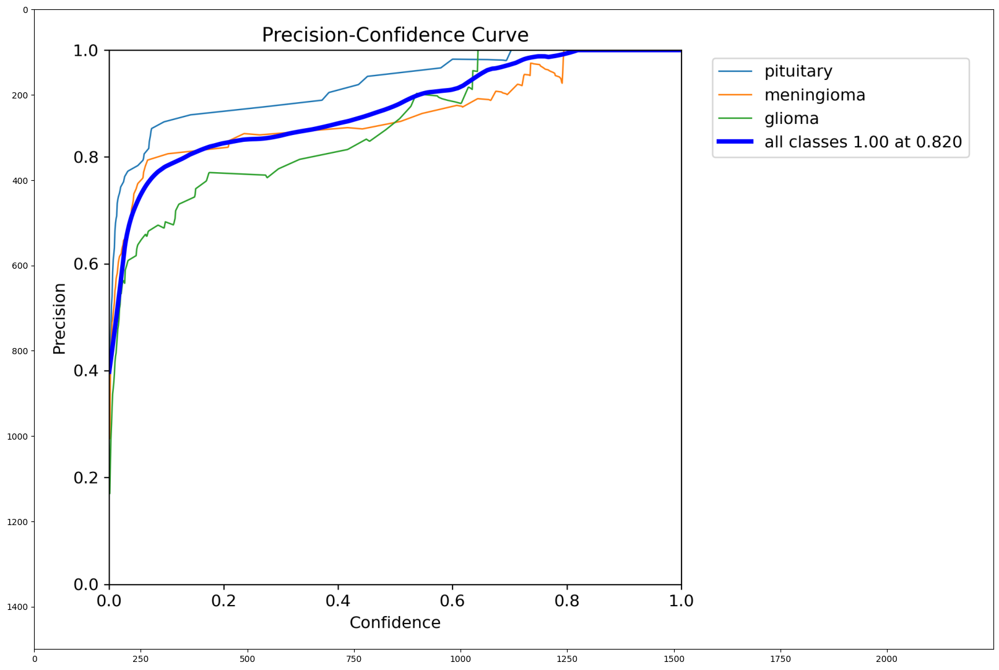

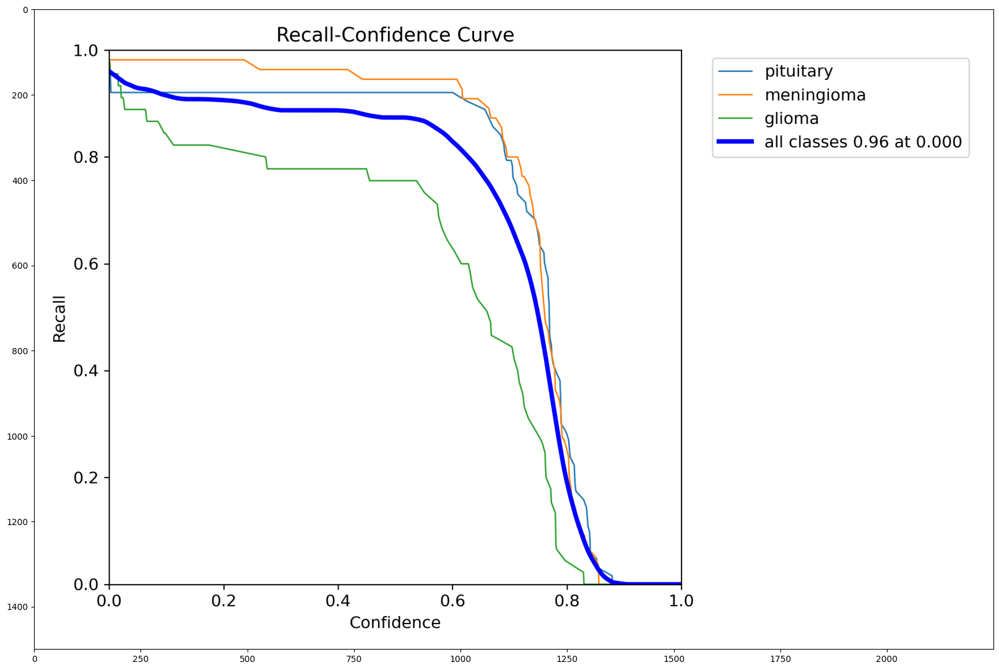

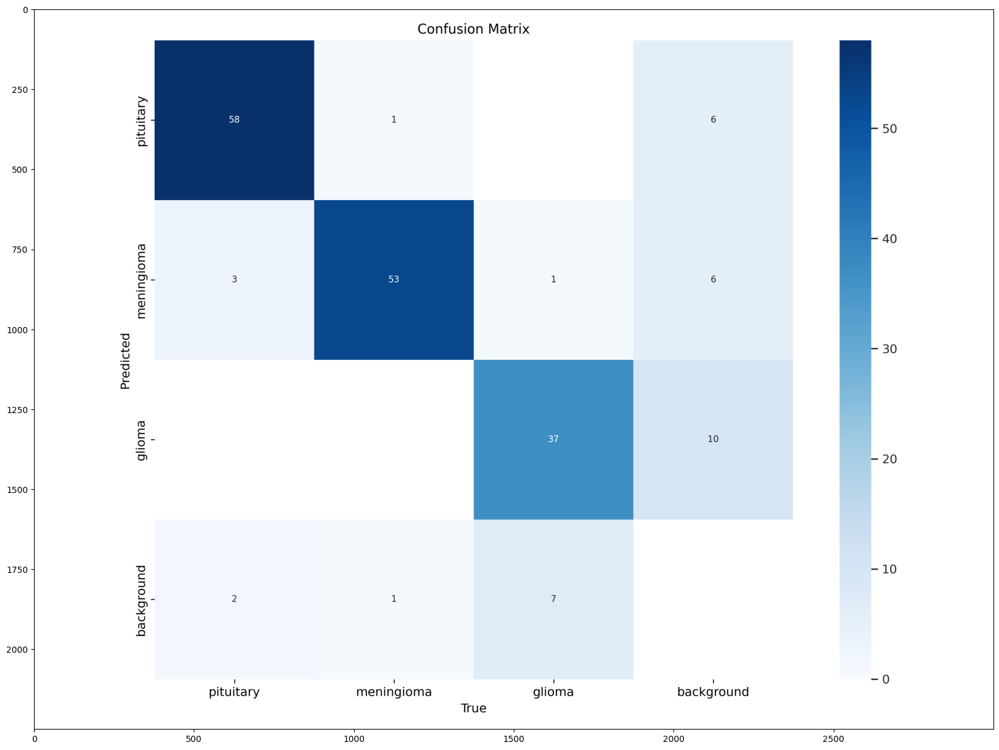

...

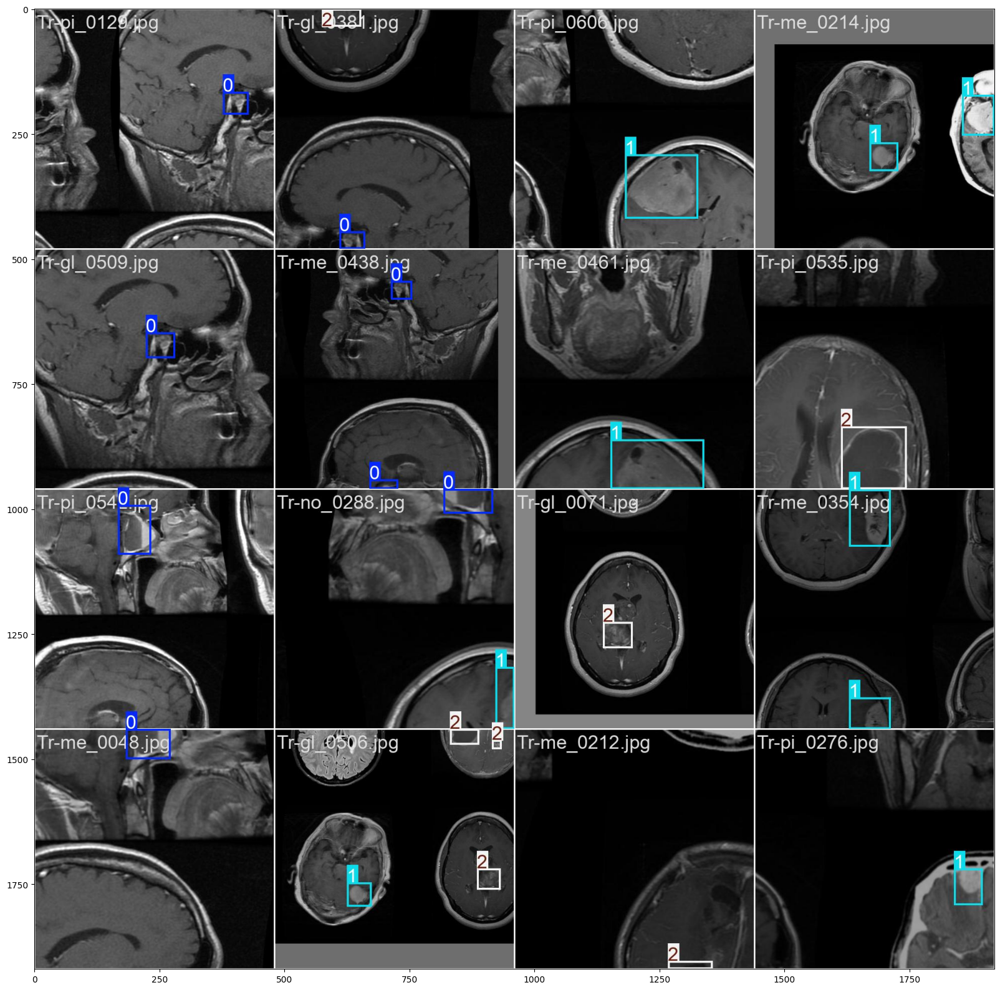

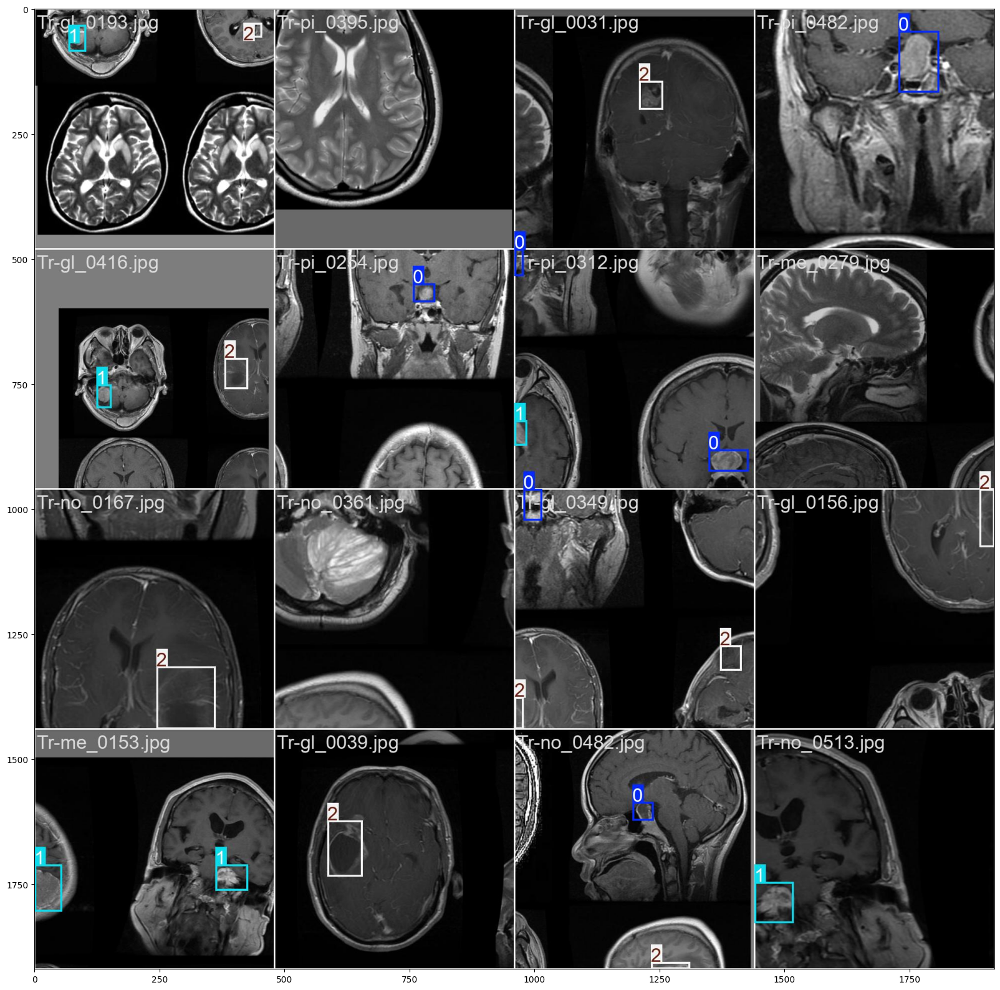

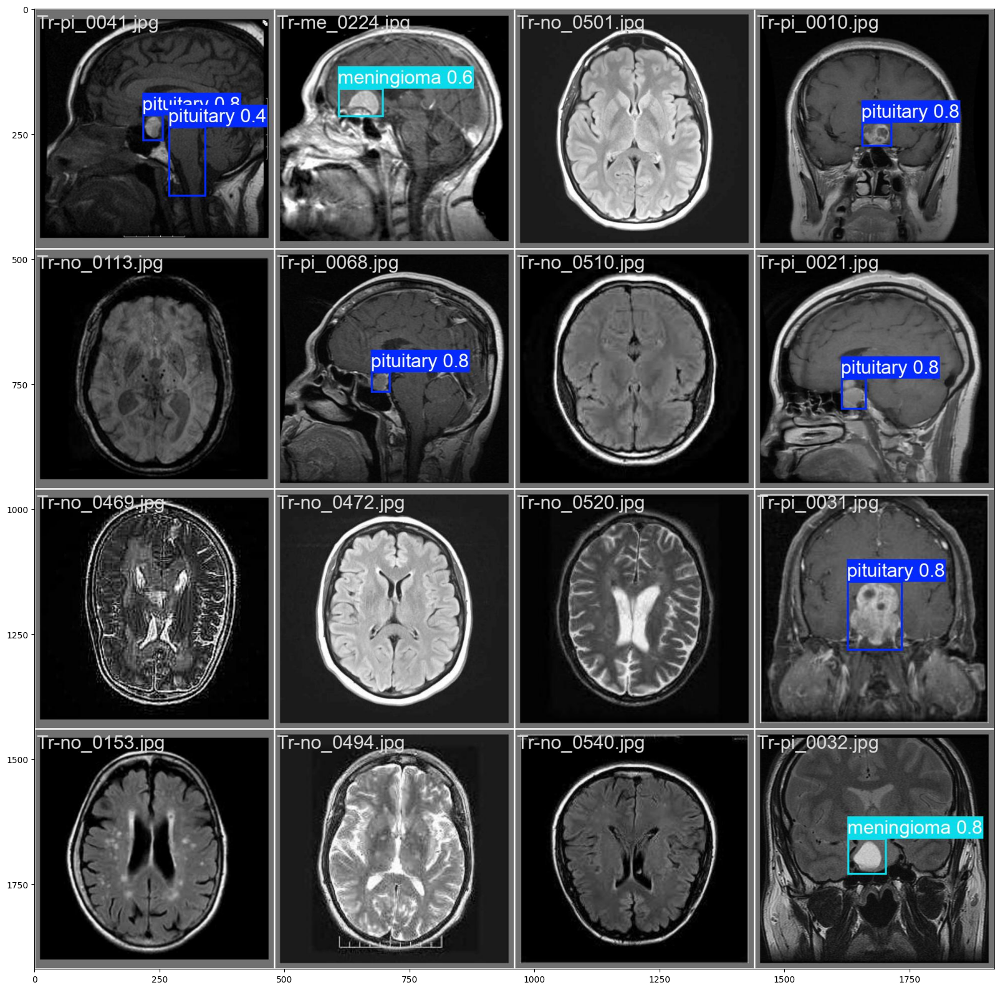

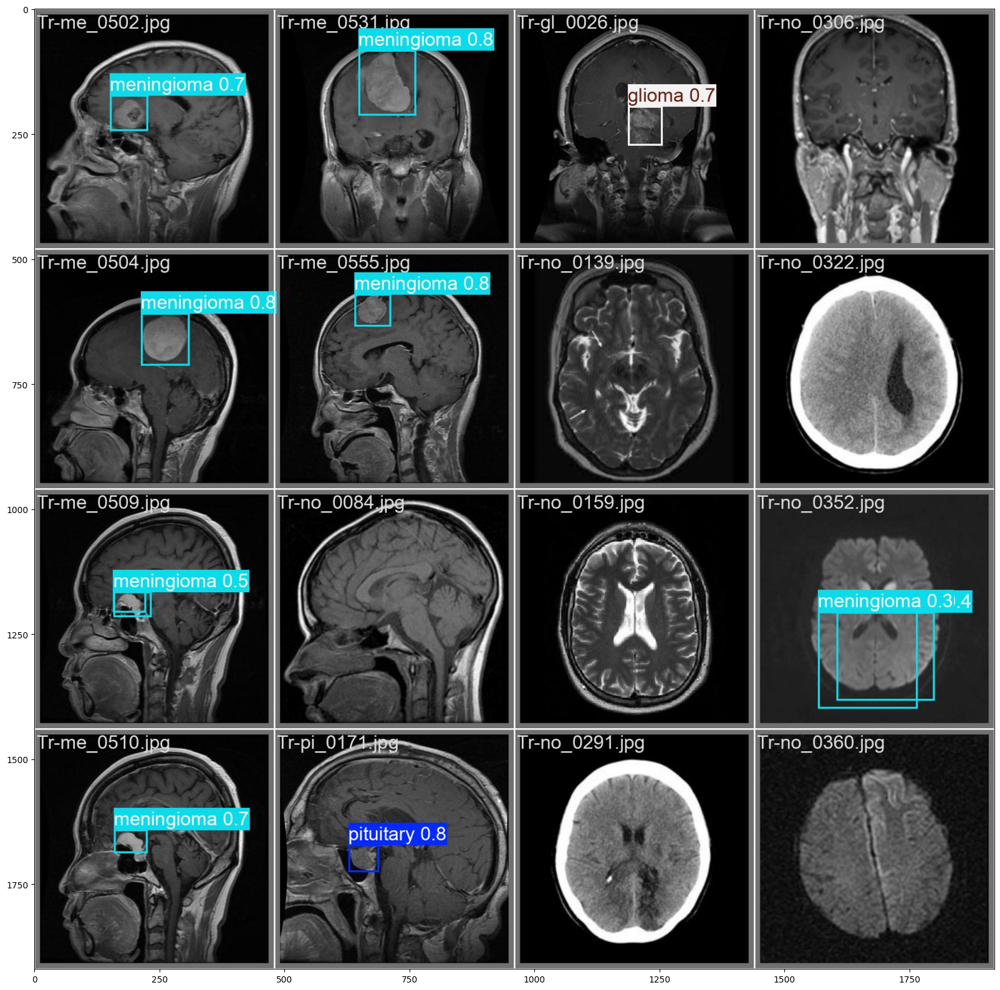

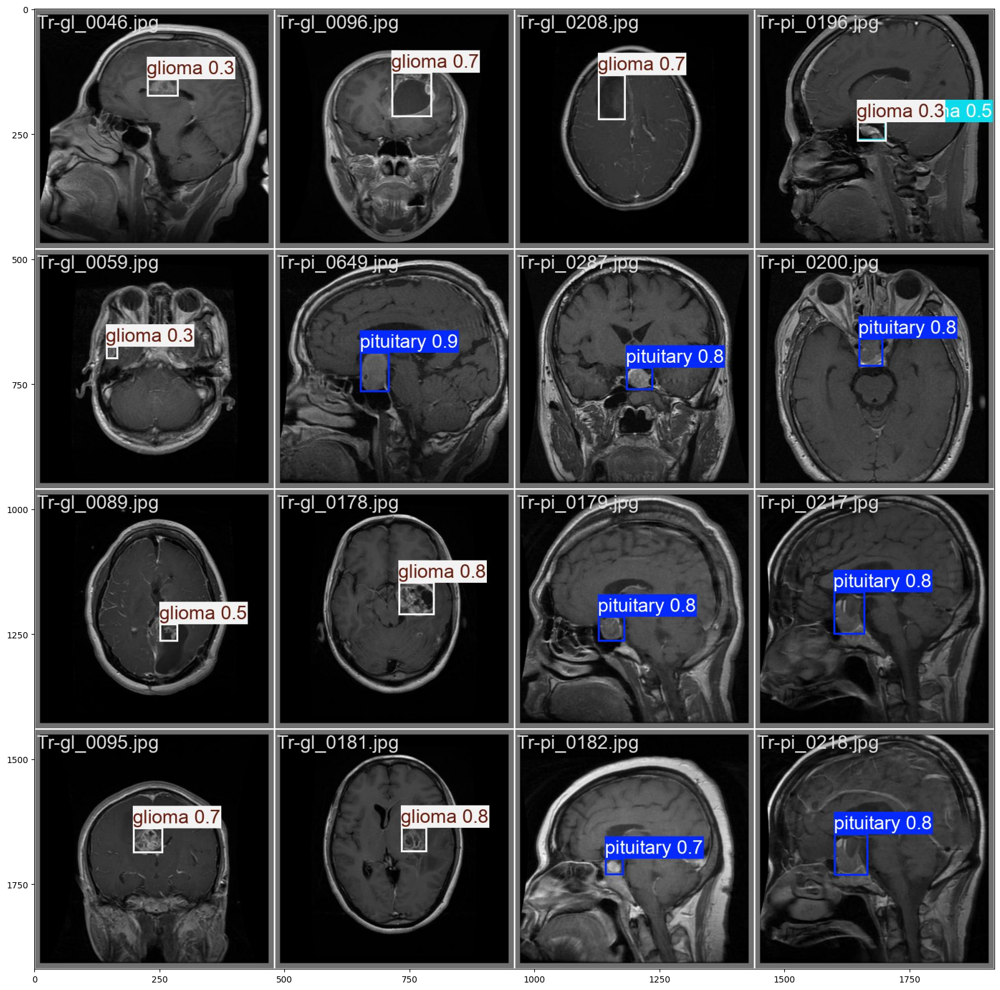

In [7]:
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train/*.jpg')):
    if not path.split('.')[0].endswith('_labels') or path.split('.')[0].startswith('train_'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()

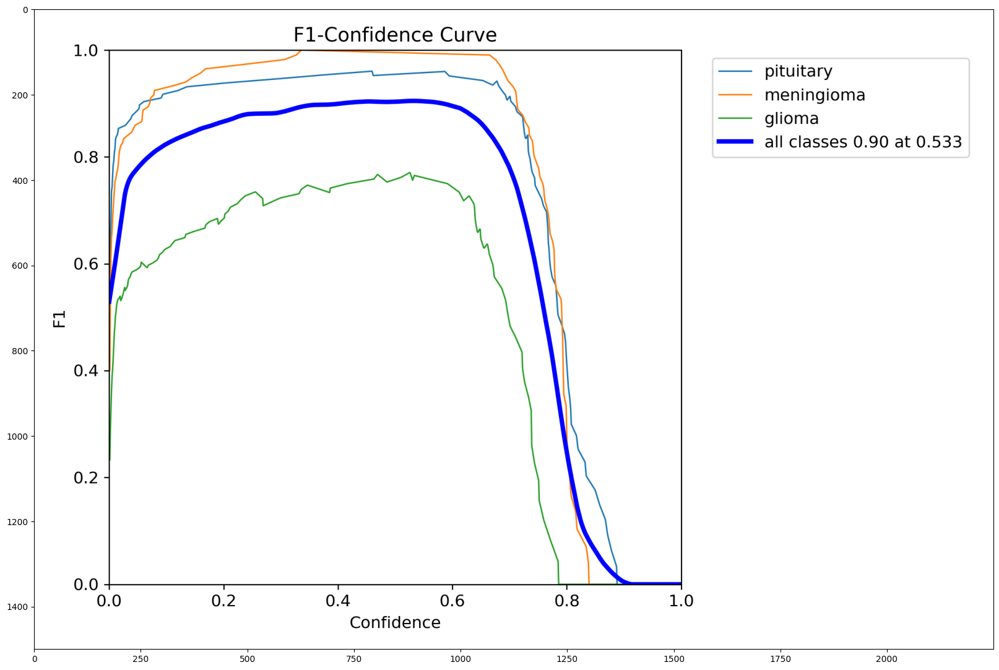

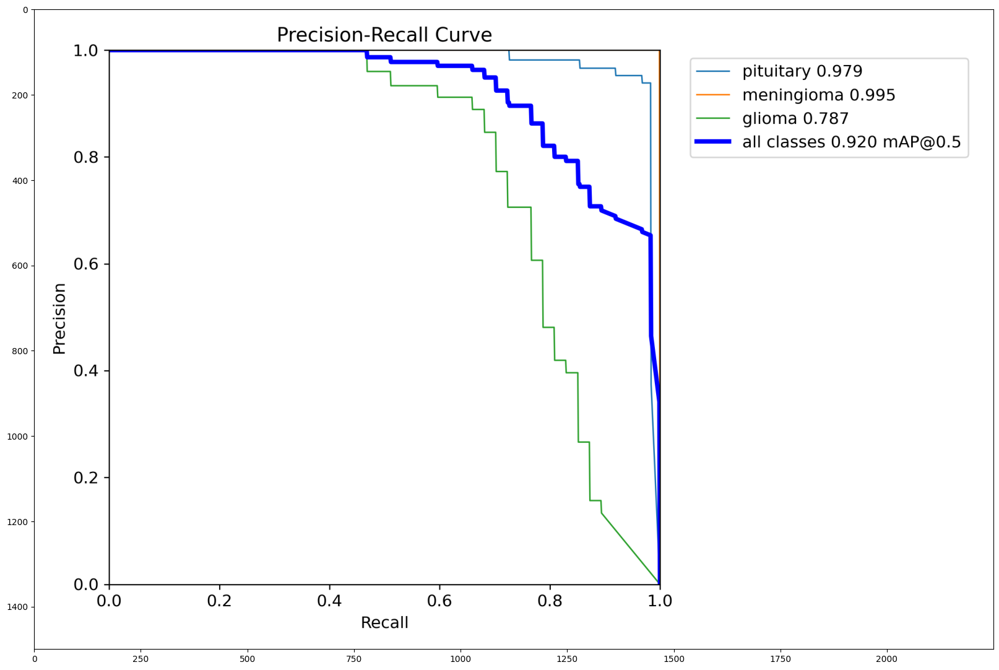

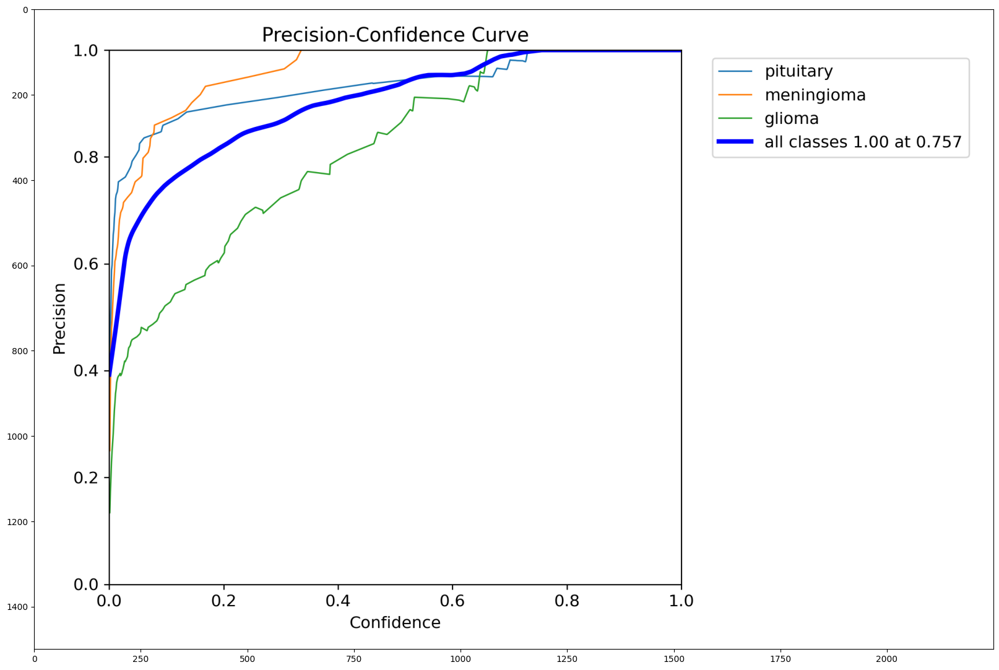

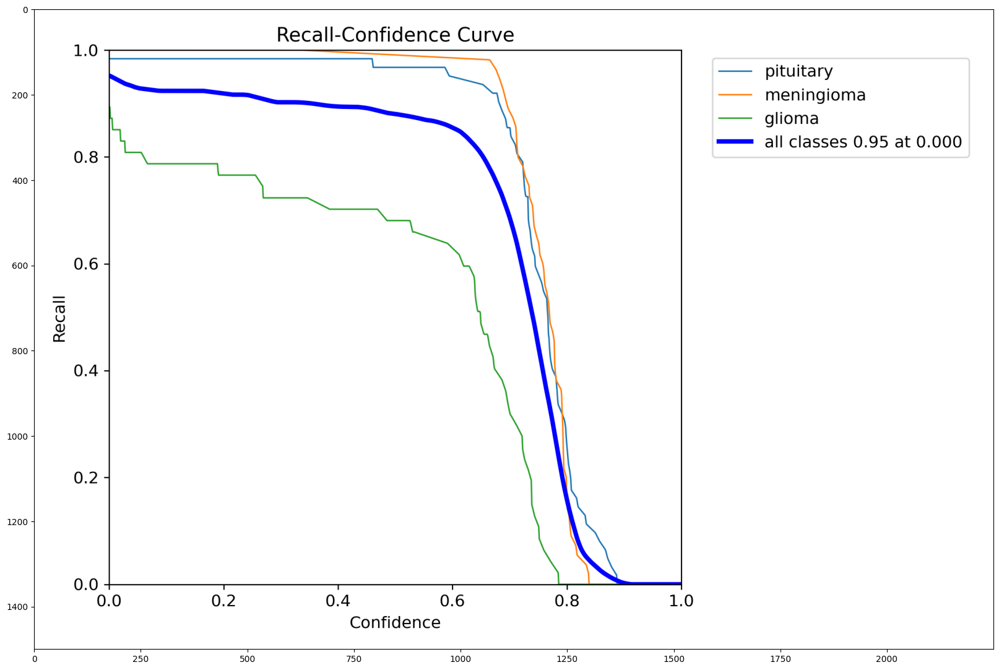

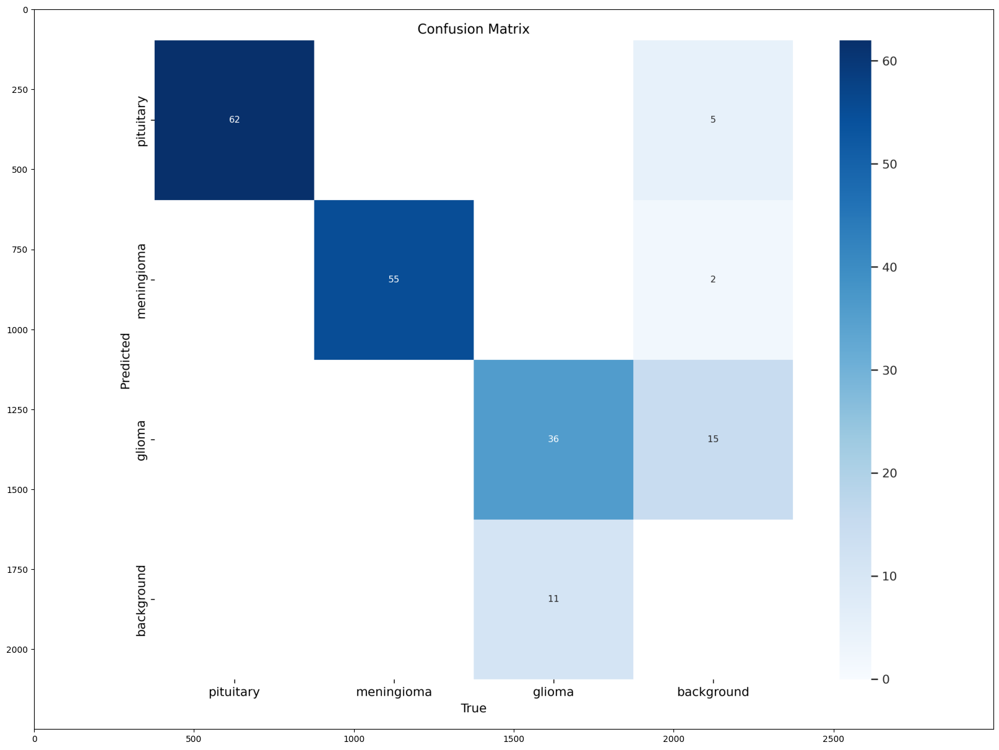

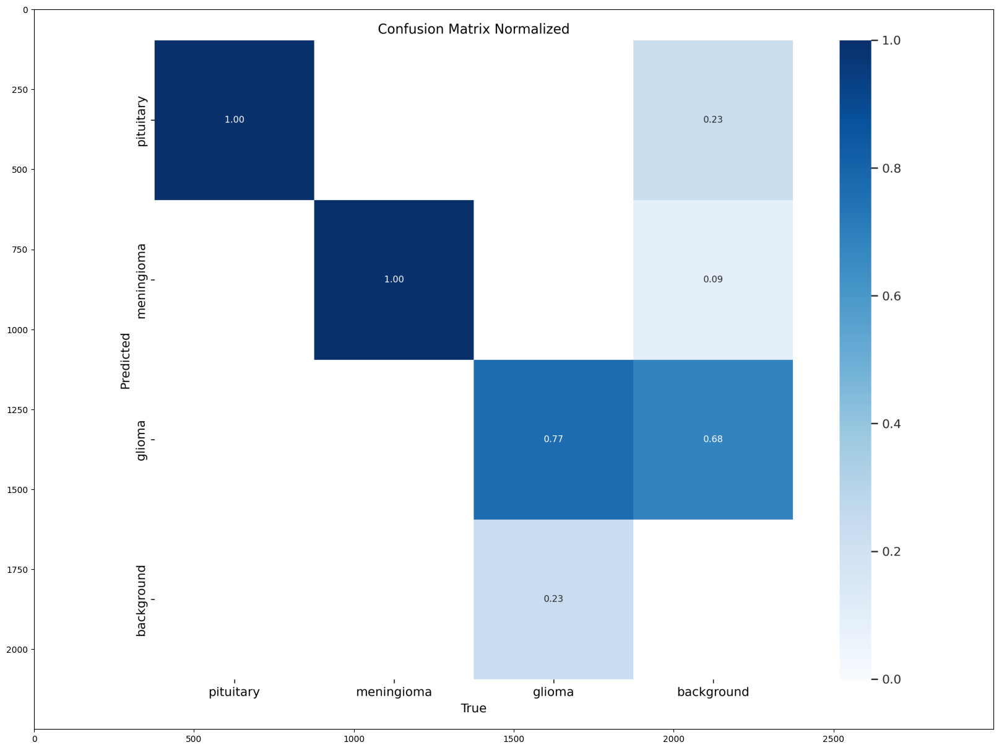

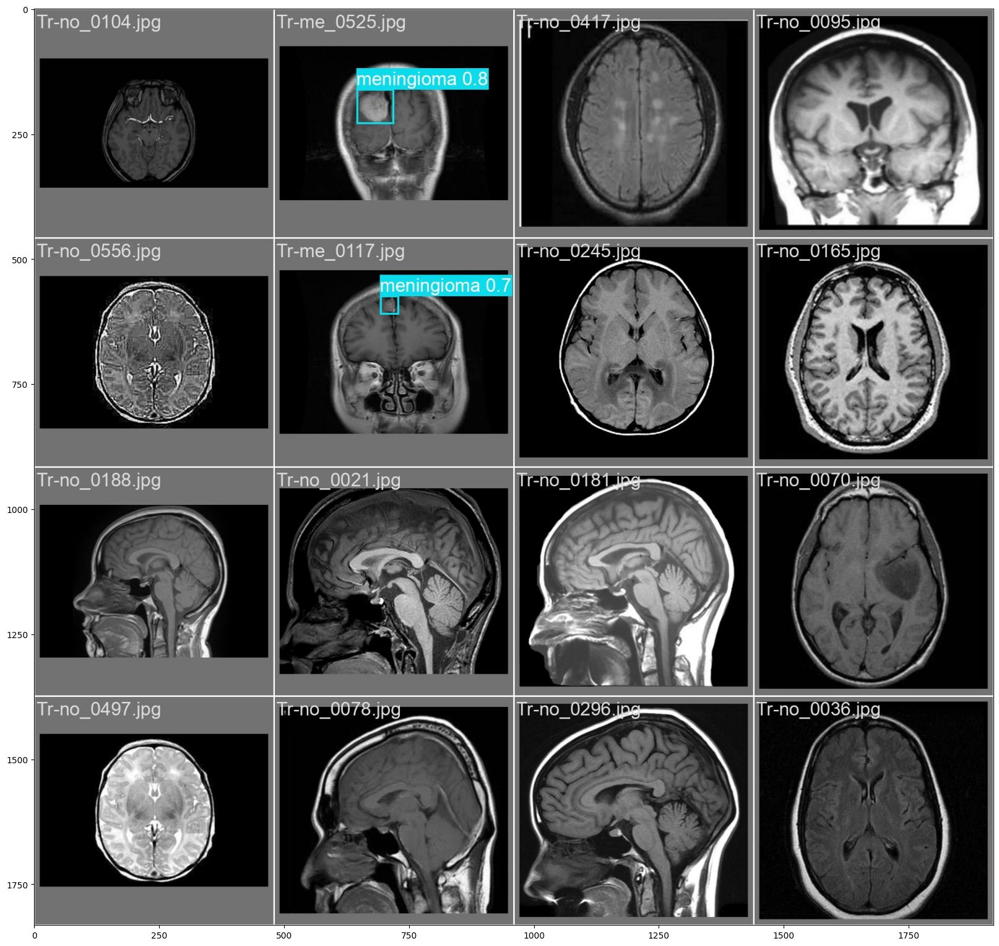

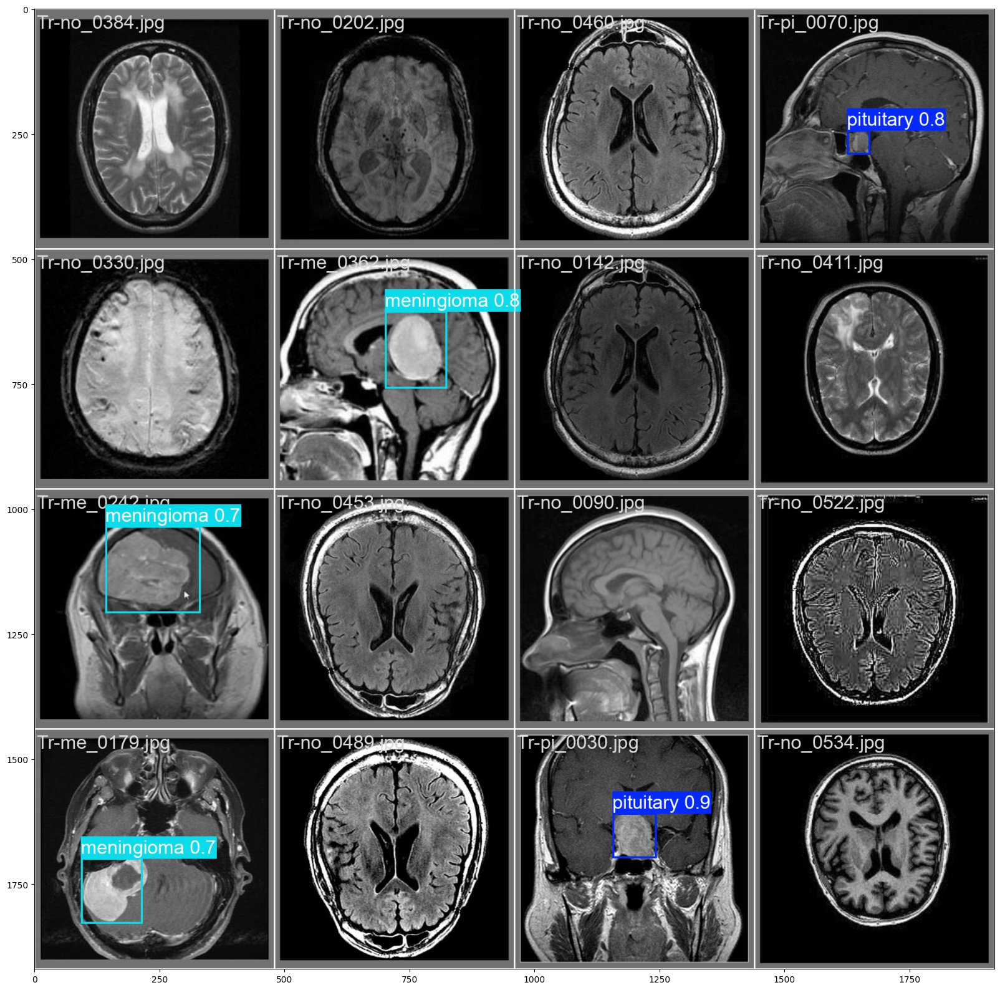

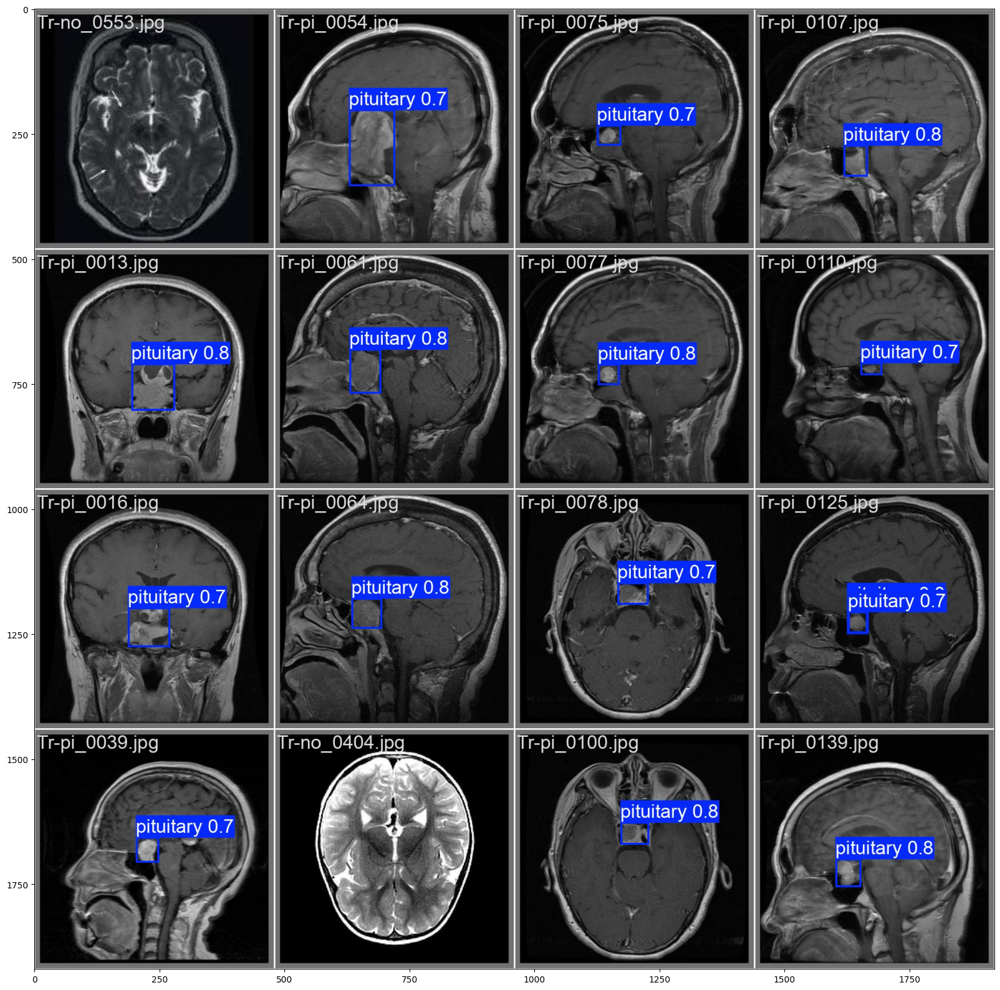

In [8]:
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train2/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train2/*.jpg')):
    if not path.split('.')[0].endswith('_labels'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()